In [1]:
import os
import pdb
import scipy.io
import cv2
from tqdm import tnrange, tqdm
import matplotlib.pyplot as plt
from itertools import groupby
from operator import itemgetter

In [2]:
from keras.models import Model
from keras.models import load_model
import keras

Using TensorFlow backend.


In [ ]:
import pickle

In [3]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]= '1,3'

In [5]:
# runs
runs_path = '/home/mjh319/workspace/runs'

runs_dict = {}
for folder_path in np.sort(os.listdir(runs_path)):
    t1 = os.path.join(runs_path,  folder_path)
    temp = t1.split('/')[-1].split('_')
    t3 = os.path.join(t1, os.listdir(t1)[0])
    model_name = temp[1] +'_'+ temp[6] +'_'+ t3.split('/')[-1]
    t2 = np.sort(os.listdir(os.path.join(t1, os.listdir(t1)[0])))
    try:
        if '100' in t2[-1]:
            model_path = os.path.join(t3,t2[-1])
        runs_dict[model_name] = model_path
    except:
        print(t2)


runs_dict

{'avenue_2_ours': '/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_2_epochs_100_model_convLSTM_res_attention_pred_checkname_ours/ours/100-0.00013349.hdf5',
 'avenue_3_no_residual': '/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_3_epochs_100_model_convLSTM_attention_pred_checkname_no_residual/no_residual/100-0.00007328.hdf5',
 'avenue_3_whole_actication': '/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_3_epochs_100_model_convLSTM_attention_pred_checkname_whole_actication/whole_actication/100-0.00007311.hdf5',
 'avenue_3_convLSTM_res_attention_pred': '/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_3_epochs_100_model_convLSTM_res_attention_pred_checkname_convLSTM_res_attention_pred/convLSTM_res_attention_pred/100-0.00007145.hdf5',
 'avenue_3_ours2221122': '/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_3_epochs_100_model_convLSTM_res_attention_pred_checkname_ours2221122/ours2221122/100

In [4]:
def Y_label_generator_2(dataset=False):
    
        
    if dataset == 'avenue':
        test_videos_path = './data/Avenue Dataset/testing_frames/'
    elif dataset == 'ped1' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'        
    elif dataset == 'ped2' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped2/'
    elif dataset == 'enter' :
        test_videos_path = './data/subway/enter/testing_frames/'
    elif dataset == 'exit' :
        test_videos_path = './data/subway/exit/testing_frames/'
        
    if dataset =='avenue' or dataset == 'enter' or dataset == 'exit':
        test_video_list = np.sort(os.listdir(test_videos_path))
    elif dataset == 'ped1' or dataset == 'ped2':
        test_video_list = np.sort([folder for folder in os.listdir(os.path.join(test_videos_path,'Test')) if 'Test' in folder if 'gt' not in folder])
    elif dataset == 'shang':
        test_video_list = 'shang'
        
    Y_label = dict()
    if dataset == 'avenue':
        gt = scipy.io.loadmat('./data/Avenue Dataset/' + 'gt_avenue.mat')
    elif dataset == 'ped1' :
        gt = scipy.io.loadmat('./data/UCSD_Anomaly_Dataset/' + 'gt_ped1.mat')        
    elif dataset == 'ped2' :
        gt = scipy.io.loadmat('./data/UCSD_Anomaly_Dataset/' + 'gt_ped2.mat')
    elif dataset == 'enter' :
        gt = scipy.io.loadmat('./data/subway/' + 'gt1_enter.mat')
    elif dataset == 'exit' :
        gt = scipy.io.loadmat('./data/subway/' + 'gt1_exit.mat')
        

    video_idx = 0
    for video in test_video_list:
        if dataset == 'shang':
            continue
        if dataset =='avenue' or dataset == 'enter' or dataset == 'exit':
            video_length = len(os.listdir(os.path.join(test_videos_path,video)))
            video_frames = [str(file) + '.jpg' for file in list(range(video_length))]

        elif dataset == 'ped1' or dataset == 'ped2':  
            video_frames = np.sort([file for file in os.listdir(os.path.join(test_videos_path,'Test',video)) if 'tif' in file])
            video_length = len(video_frames)

        Y_label_temp =  np.array([0 for _ in range(video_length)])

        for i in range(gt['gt'][0][video_idx].shape[-1]):
            Y_label_temp[gt['gt'][0][video_idx][0][i]:gt['gt'][0][video_idx][1][i]] = 1

        Y_label[video] = Y_label_temp
#         print(video , ":", 'original length =', video_length)
        video_idx += 1
        
        
        
    if dataset == 'shang':
        test_dir = './data/shanghaitech/testing'
        videos = np.sort(os.listdir(os.path.join(test_dir,  'test_frame_mask')))
        Y_label = dict()
        for video in videos:
            Y_label[video.split('.')[0]] = np.load(os.path.join(test_dir,'test_frame_mask', video))
                    
        
    return Y_label

In [11]:
# result check
# def check_result(selected_test_video = 0, \
#                  model_name = 'avenue_3_no_residual', image_size = 224,\
#                 sequence_start_idx = 4):
    

#     label = Y_label_generator_2(model_name.split('_')[0])
    
#     dataset = model_name.split('_')[0]
#     stride = 1
#     timesteps = int(model_name.split('_')[1])
    
    
#     if dataset =='avenue':
#         test_videos_path = './data/Avenue Dataset/testing_frames/'
#     elif dataset == 'ped1' :
#         test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'
#     elif dataset == 'ped2' :
#         test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped2/'
#     elif dataset == 'enter' :
#         test_videos_path = './data/subway/enter/testing_frames/'
#     elif dataset == 'exit' :
#         test_videos_path = './data/subway/exit/testing_frames/'
#     elif dataset == 'shang':
#         test_videos_path = './data/shanghaitech/testing/frames/'       
        
#     all_mse = dict()
#     if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
#         test_video_list = np.sort(os.listdir(test_videos_path))
#     elif dataset == 'ped1' or dataset == 'ped2':
#         test_video_list = np.sort([folder for folder in os.listdir(os.path.join(test_videos_path,'Test')) if 'Test' in folder if 'gt' not in folder])


#     test_label = {}    
#     check = -1     
#     print("video list len {}".format(len(test_video_list)))
#     for video in test_video_list :
#         check += 1
        
#         if check != selected_test_video :
#             continue

        
#         if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
#             f_len = len(os.listdir(os.path.join(test_videos_path, video)))
#             if dataset == 'shang':
#                 video_frames = [str(file).zfill(3) + '.jpg' for file in list(range(f_len))]
#             else :
#                 video_frames = [str(file) + '.jpg' for file in list(range(f_len))]
#         elif dataset == 'ped1' or dataset == 'ped2':    
#             video_frames = np.sort([file for file in os.listdir(os.path.join(test_videos_path,'Test',video)) if 'tif' in file])
#             f_len = len(video_frames)
            
            
#         end_idx = (f_len//stride) * stride -1
#         while end_idx + timesteps -1 > f_len -1 :
#             end_idx -= stride 

#         num_sample = (end_idx+1)//stride    
        
#         batch_size = end_idx        
#         cnt = 1
            
            
#         for i in tnrange(cnt, desc='test : {}'.format(video)):
#             batch = []
#             batch_y = [] 
#             normal_batch = []
            
#             for sequence_start_idx in list(range(1,end_idx, stride))[i*batch_size:i*batch_size+batch_size]:

#                 resized_frames = [] # sequence
#                 sequence = video_frames[sequence_start_idx-1:sequence_start_idx+timesteps+1] # [t-1 , t , t+1, t+2]            


#                 # t-1 sample 
#                 if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
#                     prv = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[0]), mode='L')

#                 elif dataset == 'ped1' or dataset =='ped2':
#                     prv = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[0]), mode='L')
                    
                    
                    
#                 normal_batch.append(prv)
                

#                 prv = scipy.misc.imresize(prv, (image_size,image_size))

#                 if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
#                     frame_y = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[-1]), mode='L')

#                 elif dataset == 'ped1' or dataset =='ped2':
#                     frame_y = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[-1]), mode='L')

#                 frame_y = scipy.misc.imresize(frame_y, (image_size,image_size))
#                 batch_y.append(frame_y)

#                 for name in sequence[1:-1]:
#                     if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
#                         nxt = scipy.misc.imread(os.path.join(test_videos_path,video,name), mode='L')
#                     elif dataset == 'ped1' or dataset == 'ped2':
#                         nxt = scipy.misc.imread(os.path.join(test_videos_path,'Test',video,name), mode='L') # 'L = gray'  
                        
                        
# #                     normal_batch.append(nxt)

#                     nxt = scipy.misc.imresize(nxt, (image_size,image_size))
                    
                    
                    

#                     flow = cv2.calcOpticalFlowFarneback(prv,nxt, None, 0.5, 3, 15, 3, 5, 1.2, 0)
#                     mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])

#                     hsv = np.zeros((image_size,image_size,3))
#                     hsv[...,1] = 255.  
#                     hsv[...,0] = ang*180/np.pi/2
#                     hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
#                     hsv = np.uint8(hsv) 

#                     rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)
#                     rgb = rgb/255.             

#                     nxt = np.expand_dims(nxt, axis=-1)
#                     frame = np.concatenate([nxt/255.,rgb],axis = -1)                        
#                     resized_frames.append(frame)
#                     prv = nxt.copy()                        

#                 resized_frames = np.stack(resized_frames, axis=0)
#                 batch.append(resized_frames)

#             if batch !=[]: 
#                 batch = np.stack(batch, axis = 0)
#                 normal_batch = np.stack(normal_batch, axis = 0)
#                 batch_y = np.stack(batch_y, axis = 0)
#                 batch_y = np.expand_dims(batch_y/255., axis=-1)
                
#         test_label[video] = label[video][timesteps+1 : ]
#         label_each, = np.where(test_label[video] == 1)
#         return_label = test_label[video]
        
# #         groups = []
# #         for k, g in groupby(enumerate(label_each), lambda x: x[0]-x[1]):
# #             groups.append(list(map(itemgetter(1), g)))

#         plt.figure(figsize=(20,5))
#         plt.xlabel('Frame number')
# #         plt.ylabel('Nomalized MSE')
#         plt.title('{} video #{}'.format(dataset, video))
#         plt.plot(test_label[video])
# #         for i in range(len(groups)):
# #             plt.axvspan(groups[i][0] , groups[i][-1], facecolor='r', alpha=0.2)
#         plt.show()

#     return batch, normal_batch, return_label


In [70]:
# result chec222
def check_result(selected_test_video = 0, \
                 model_name = 'avenue_3_no_residual', image_size = 224,\
                sequence_start_idx = 4, video_range1 = 0,
                video_range2 = 100):
    
    mse_path = '/home/mjh319/workspace/video_anomaly/mse/'

    label = Y_label_generator_2(model_name.split('_')[0])
    
    dataset = model_name.split('_')[0]
    stride = 1
    timesteps = int(model_name.split('_')[1])
    
    
    
    if dataset =='avenue':
        test_videos_path = './data/Avenue Dataset/testing_frames/'
    elif dataset == 'ped1' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'
    elif dataset == 'ped2' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped2/'
    elif dataset == 'enter' :
        test_videos_path = './data/subway/enter/testing_frames/'
    elif dataset == 'exit' :
        test_videos_path = './data/subway/exit/testing_frames/'
    elif dataset == 'shang':
        test_videos_path = './data/shanghaitech/testing/frames/'       
        
    all_mse = dict()
    if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
        test_video_list = np.sort(os.listdir(test_videos_path))
    elif dataset == 'ped1' or dataset == 'ped2':
        test_video_list = np.sort([folder for folder in os.listdir(os.path.join(test_videos_path,'Test')) if 'Test' in folder if 'gt' not in folder])


    test_label = {}    
    
    len_ = 0
   

    print("video list len {}".format(len(test_video_list)))
    for idx, video in enumerate(test_video_list) :
        
        if idx != selected_test_video :
            len_ += len(label[video])
            continue

        
        if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
            f_len = len(os.listdir(os.path.join(test_videos_path, video)))
            if dataset == 'shang':
                video_frames = [str(file).zfill(3) + '.jpg' for file in list(range(f_len))]
            else :
                video_frames = [str(file) + '.jpg' for file in list(range(f_len))]
            
            if dataset == 'exit':
                video_frames = video_frames[video_range1:video_range2]
                f_len = len(video_frames)
                label[video] = label[video][video_range1:video_range2]
                
            if dataset == 'enter':
                video_frames = video_frames[video_range1:video_range2]
                f_len = len(video_frames)
                label[video] = label[video][video_range1:video_range2]
                
        elif dataset == 'ped1' or dataset == 'ped2':    
            video_frames = np.sort([file for file in os.listdir(os.path.join(test_videos_path,'Test',video)) if 'tif' in file])
            f_len = len(video_frames)
            
            
        with open(os.path.join(mse_path, model_name + '.pkl'), 'rb') as f:
            mse = pickle.load(f)
        mse = mse[len_:len_+f_len]
            
            
            
        end_idx = (f_len//stride) * stride -1
        while end_idx + timesteps -1 > f_len -1 :
            end_idx -= stride 

        num_sample = (end_idx+1)//stride    
        
        batch_size = end_idx        
        cnt = 1
            
            
        for i in tnrange(cnt, desc='test : {}'.format(video)):
            batch = []
            batch_y = [] 
            normal_batch = []
            
            for sequence_start_idx in list(range(1,end_idx, stride))[i*batch_size:i*batch_size+batch_size]:

                resized_frames = [] # sequence
                sequence = video_frames[sequence_start_idx-1:sequence_start_idx+timesteps+1] # [t-1 , t , t+1, t+2]            


                # t-1 sample 
                if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                    prv = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[0]), mode='L')

                elif dataset == 'ped1' or dataset =='ped2':
                    prv = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[0]), mode='L')
                    
                    
                    
                normal_batch.append(prv)
                

                prv = scipy.misc.imresize(prv, (image_size,image_size))

                if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                    frame_y = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[-1]), mode='L')

                elif dataset == 'ped1' or dataset =='ped2':
                    frame_y = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[-1]), mode='L')

                frame_y = scipy.misc.imresize(frame_y, (image_size,image_size))
                batch_y.append(frame_y)

                for name in sequence[1:-1]:
                    if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                        nxt = scipy.misc.imread(os.path.join(test_videos_path,video,name), mode='L')
                    elif dataset == 'ped1' or dataset == 'ped2':
                        nxt = scipy.misc.imread(os.path.join(test_videos_path,'Test',video,name), mode='L') # 'L = gray'  

                    nxt = scipy.misc.imresize(nxt, (image_size,image_size))
                    
                    
                    

                    flow = cv2.calcOpticalFlowFarneback(prv,nxt, None, 0.5, 3, 15, 3, 5, 1.2, 0)
                    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])

                    hsv = np.zeros((image_size,image_size,3))
                    hsv[...,1] = 255.  
                    hsv[...,0] = ang*180/np.pi/2
                    hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
                    hsv = np.uint8(hsv) 

                    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)
                    rgb = rgb/255.             

                    nxt = np.expand_dims(nxt, axis=-1)
                    frame = np.concatenate([nxt/255.,rgb],axis = -1)                        
                    resized_frames.append(frame)
                    prv = nxt.copy()                        

                resized_frames = np.stack(resized_frames, axis=0)
                batch.append(resized_frames)

            if batch !=[]: 
                batch = np.stack(batch, axis = 0)
                normal_batch = np.stack(normal_batch, axis = 0)
                batch_y = np.stack(batch_y, axis = 0)
                batch_y = np.expand_dims(batch_y/255., axis=-1)
                
        test_label[video] = label[video][timesteps+1 : ]
        label_each, = np.where(test_label[video] == 1)
        return_label = test_label[video]
        
        groups = []
        for k, g in groupby(enumerate(label_each), lambda x: x[0]-x[1]):
            groups.append(list(map(itemgetter(1), g))) 
    

        plt.figure(figsize=(20,5))
        plt.xlabel('Frame number')
        plt.title('{} video #{}'.format(dataset, video))
        plt.plot(mse)
        for i in range(len(groups)):
            plt.axvspan(groups[i][0] , groups[i][-1], facecolor='r', alpha=0.2)

        plt.show()

    return batch, normal_batch, return_label, mse

# avenue

## analysis

video list len 21


/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:89: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:99: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:102: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:107: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/mjh319/a

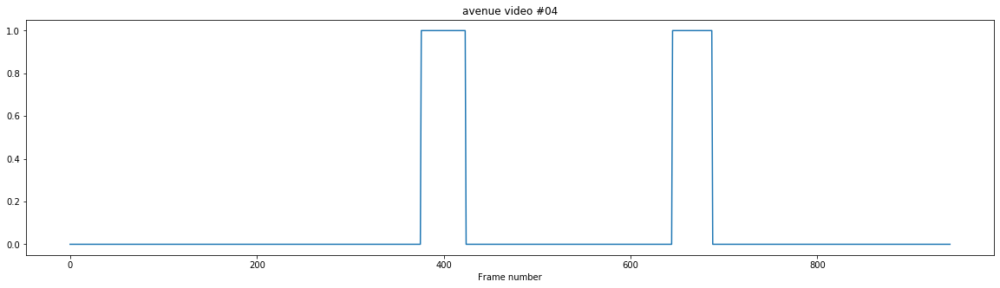

In [46]:
model_name = 'avenue_3_no_residual'

test_batch, orginal_batch, label, mse = check_result(selected_test_video = 3, \
                   model_name = model_name ,image_size = 224,\
                   sequence_start_idx = 4)

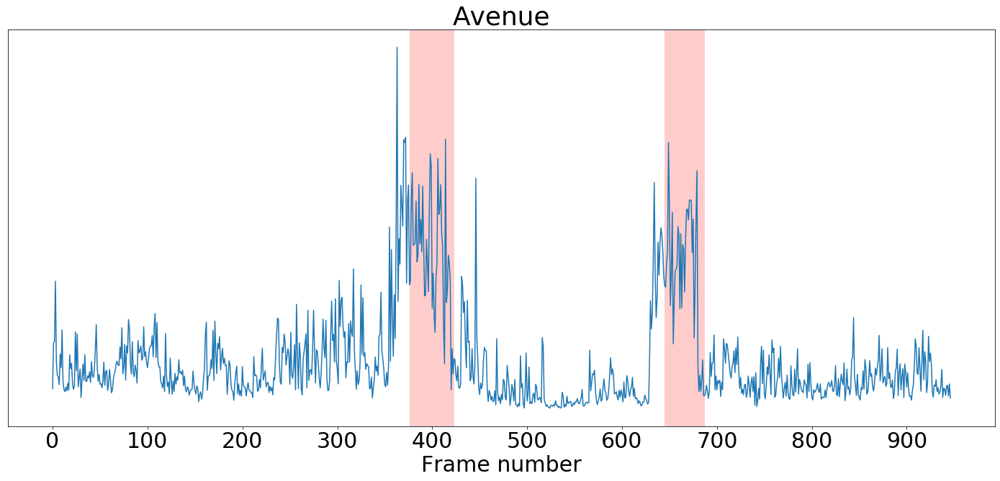

In [82]:
xmarks=[i for i in range(0,1000,100)]

label_each, = np.where(label == 1)

plt.figure(figsize=(20,10))
plt.rcParams.update({'font.size': 30})
groups = []
for k, g in groupby(enumerate(label_each), lambda x: x[0]-x[1]):
    groups.append(list(map(itemgetter(1), g))) 


plt.xlabel('Frame number')
plt.xticks(xmarks)
plt.yticks([])
plt.title('{}'.format('Avenue'))
plt.plot(mse)
for i in range(len(groups)):
    plt.axvspan(groups[i][0] , groups[i][-1], facecolor='r', alpha=0.2)
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_mse.pdf", format = 'pdf')

plt.show()

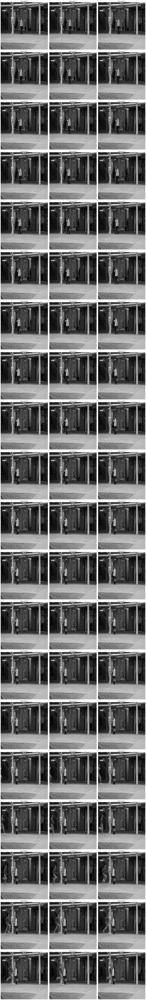

In [35]:
frame_num = 650
stack_ = 0
_,_,x,y,_ =test_batch.shape

# fig = plt.figure(figsize=(40, 40)) 
row_ = 20
col_ = 3
f, axes = plt.subplots(row_, col_, figsize=(col_*7,row_*7))

for i in range(row_):
    for j in range(col_):
        temp = test_batch[frame_num+(i*col_ + j), 0,:,:, stack_].reshape(x,y)
        axes[i][j].set_title("frame "+str(frame_num+(i*col_ + j)) +", " +str(label[frame_num+(i*col_ + j)]))
        axes[i][j].imshow(temp, cmap='gray')
        axes[i][j].axis('off')
plt.tight_layout()
plt.show()       


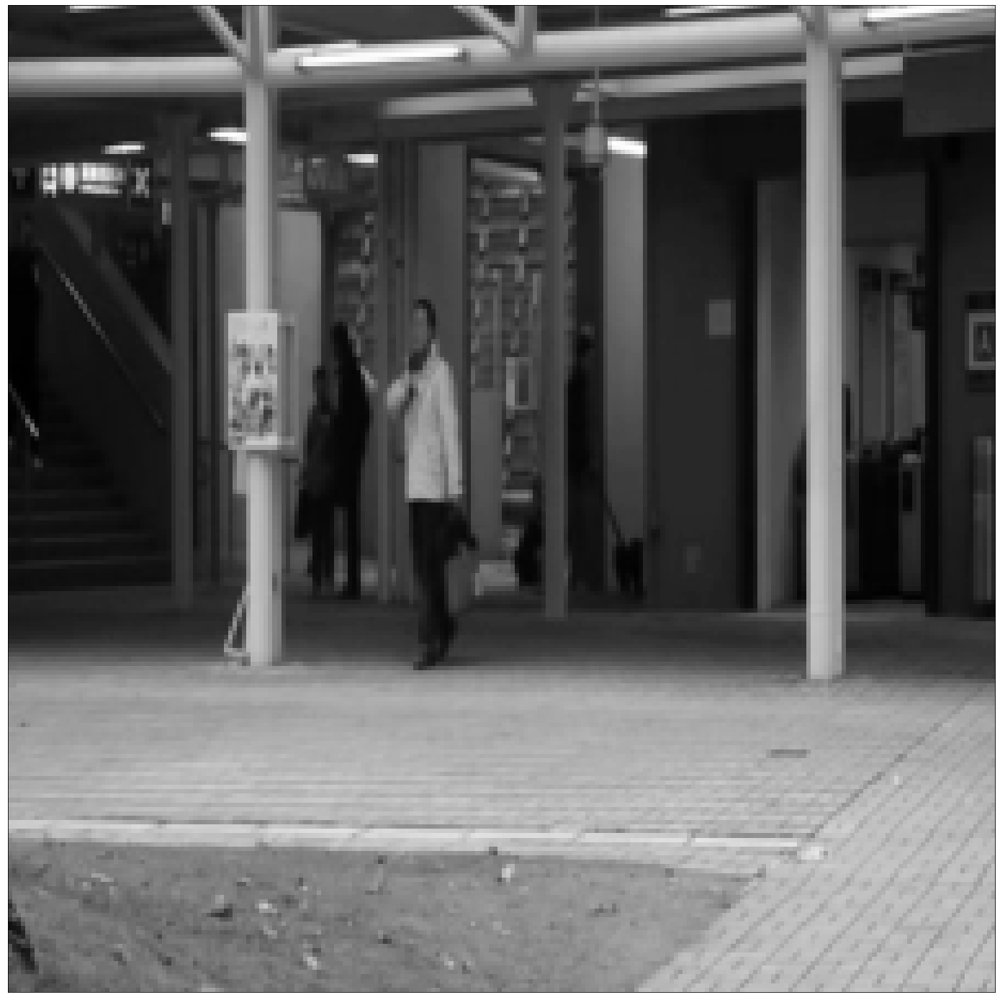

In [86]:
frame_num = 600

plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
temp = test_batch[frame_num+(i*col_ + j), 0,:,:, stack_].reshape(x,y)
plt.imshow(temp, cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal.pdf", format = 'pdf')

# plt.show()

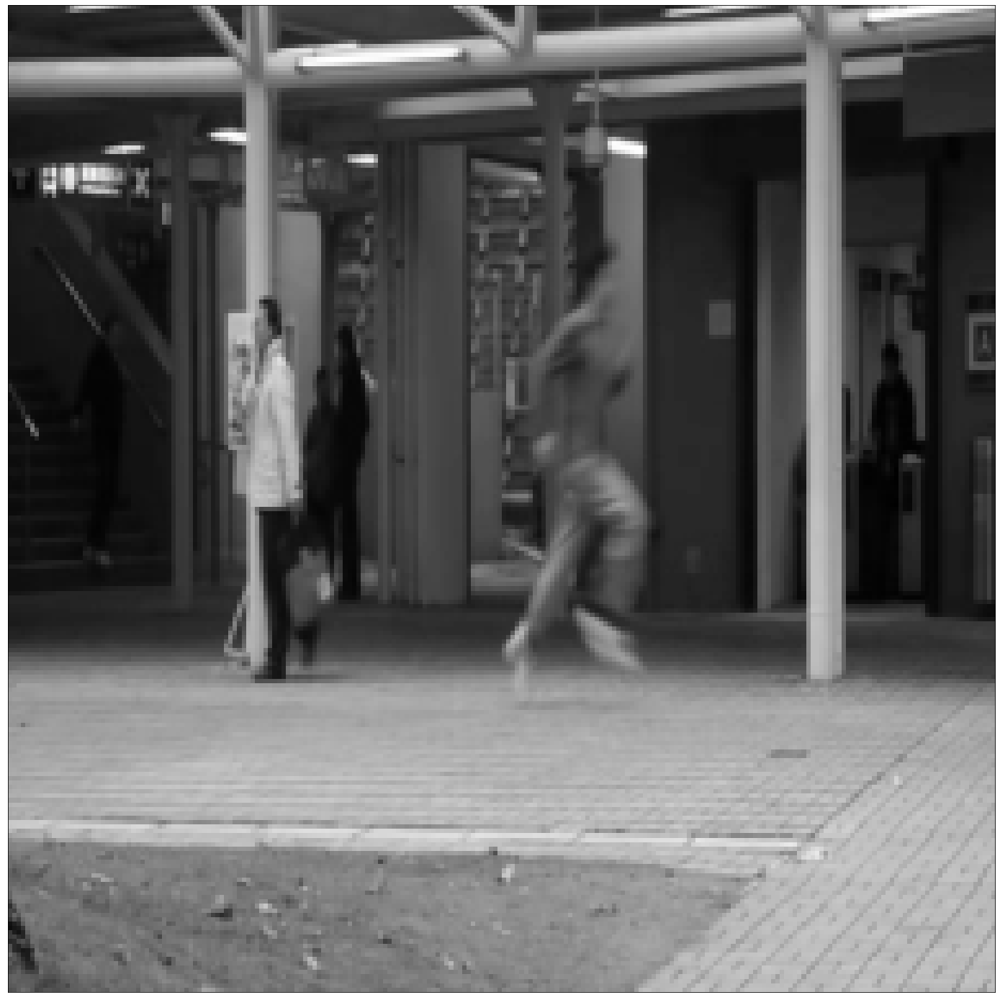

In [88]:
frame_num = 670

plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
temp = test_batch[frame_num+(i*col_ + j), 0,:,:, stack_].reshape(x,y)
plt.imshow(temp, cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal.pdf", format = 'pdf')

plt.show()

In [89]:
normal_batch = test_batch[600:605, :, :, :, :]
anomal_batch = test_batch[665:675, :, :, :, :]

## no resi

In [91]:
model_name = 'avenue_3_no_residual'
model_ = load_model(runs_dict[model_name])

In [92]:
layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        print(layer_[-1])
        print(i, len(model_.layers[3].layers))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        continue
    


1 16
2 16
3 16
4 16
5 16
6 16
7 16
8 16
9 16
10 16
11 16
12 16
13 16
14 16
15 16


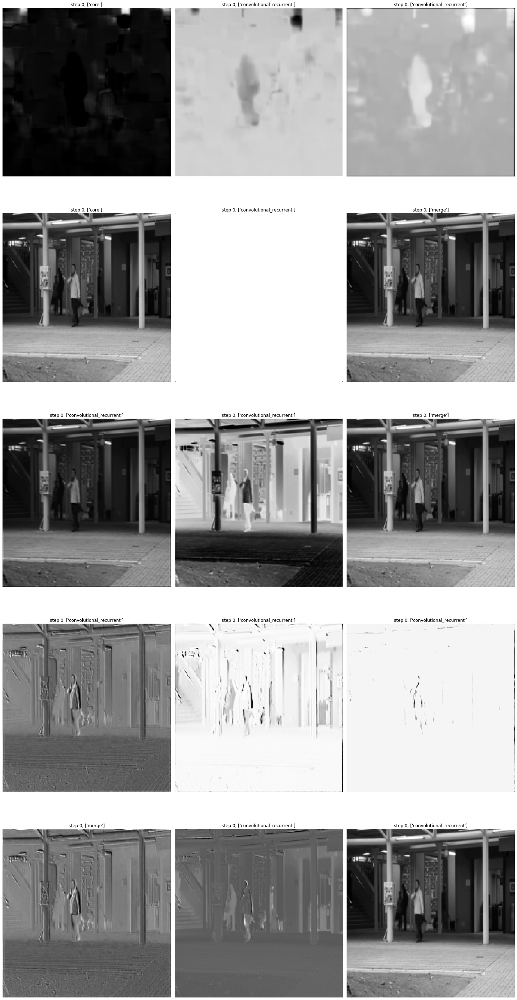

In [96]:
step = 0
idx = 0
plt.rcParams.update({'font.size': 10})

f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0], cmap='gray')            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


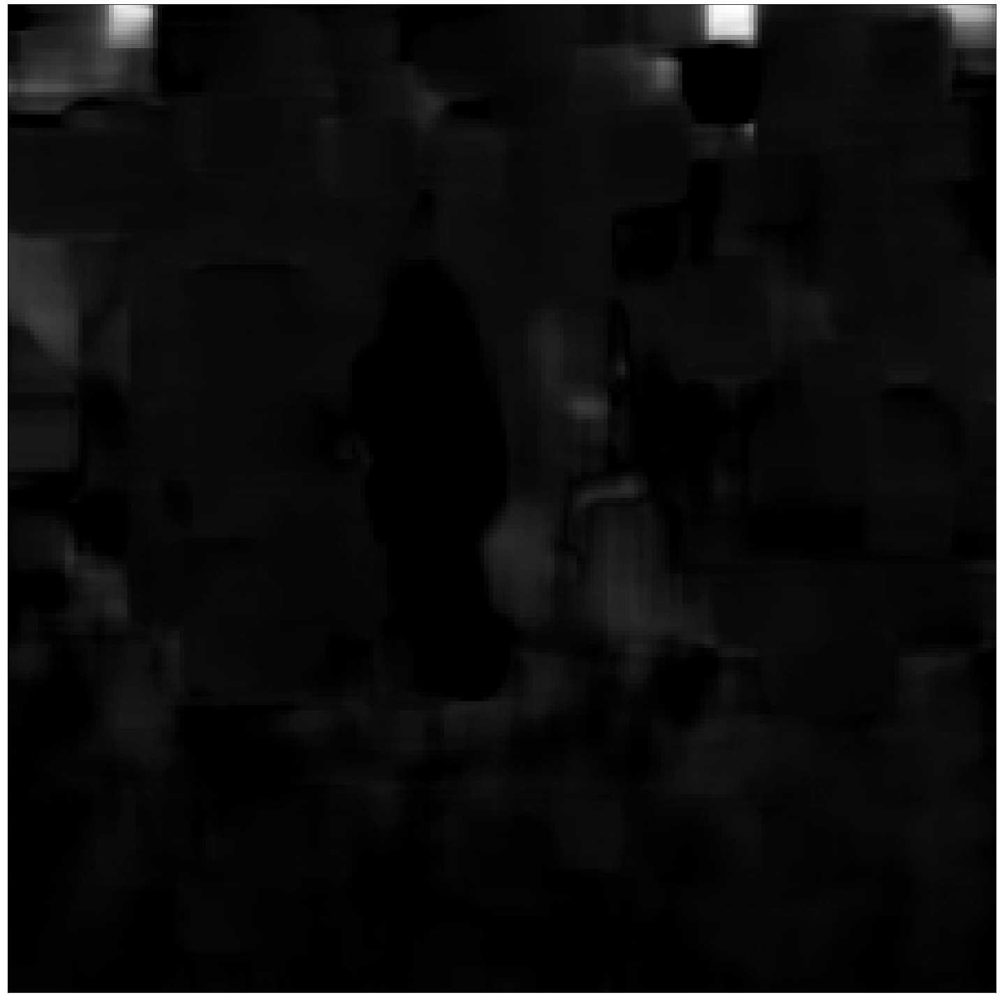

In [109]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_model_optical.pdf", format = 'pdf')

# plt.show()

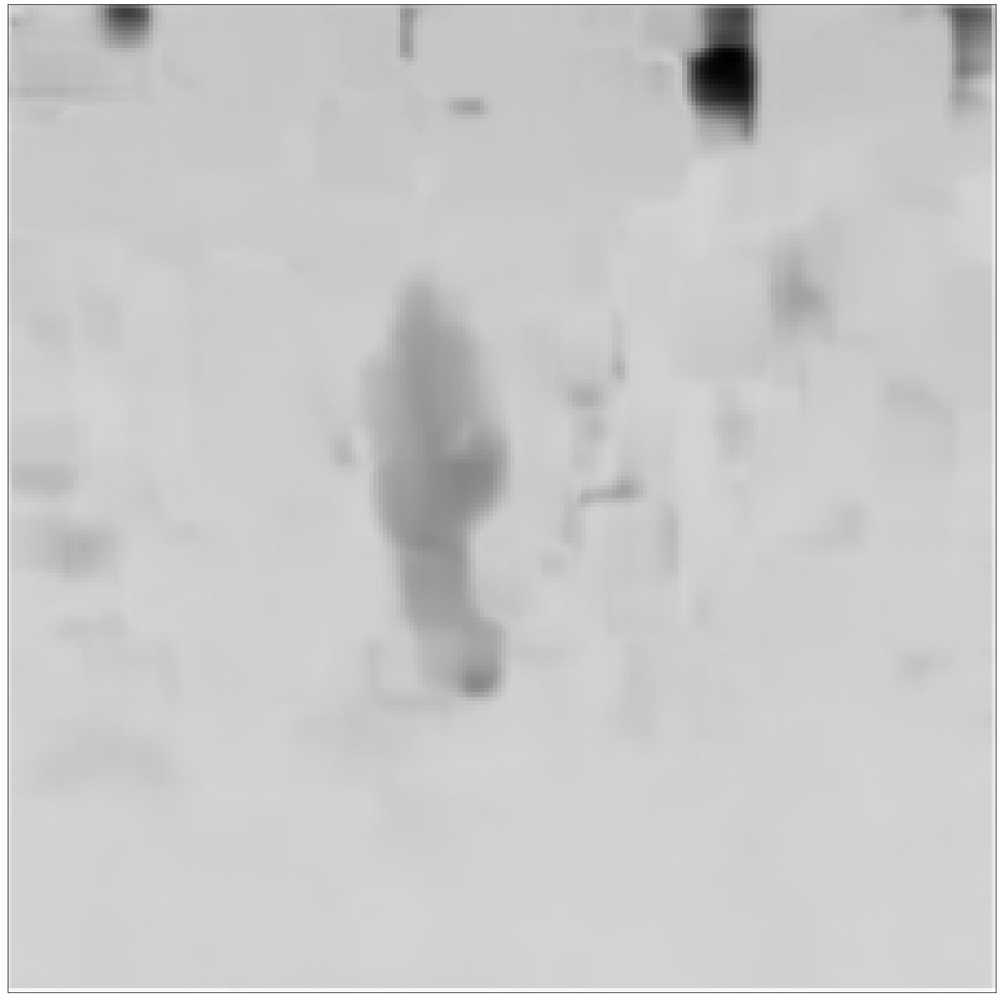

In [110]:
step = 0
idx = 1
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_model_optical_rnn.pdf", format = 'pdf')

# plt.show()

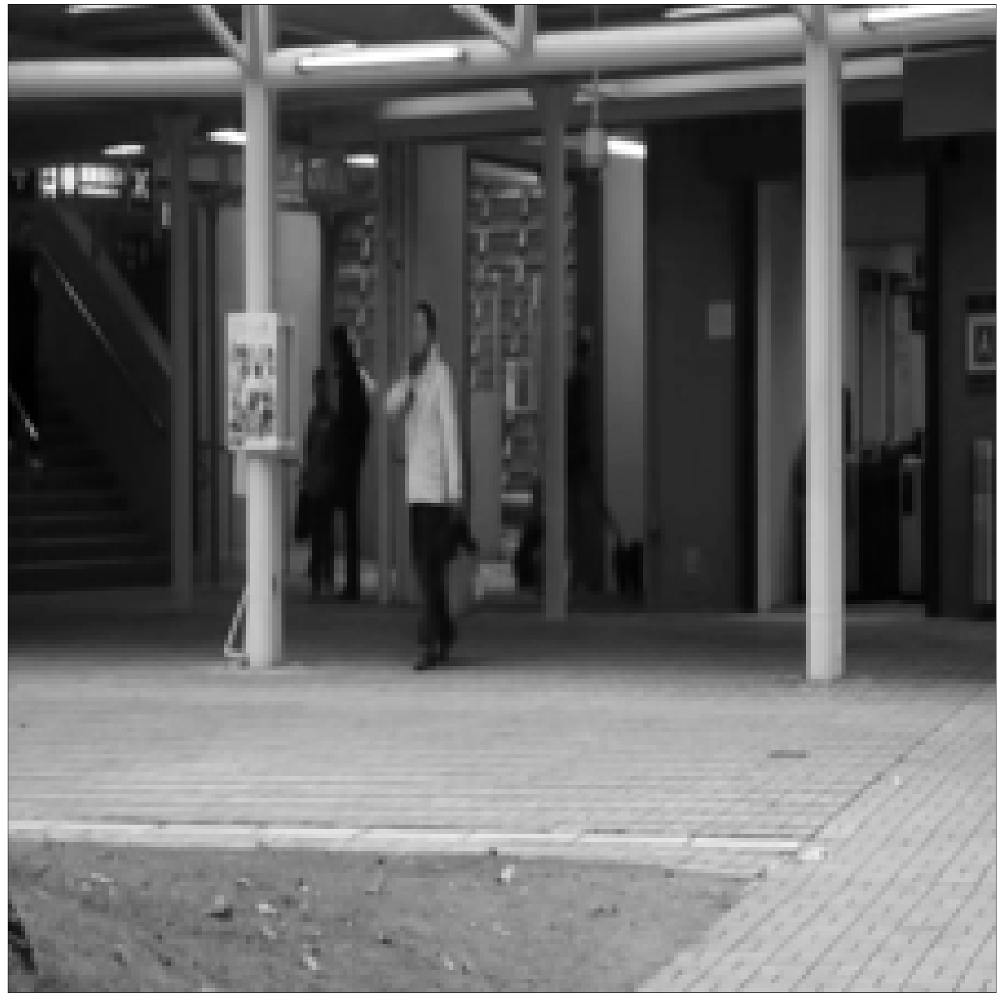

In [112]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[-1][step,:, :, 0], cmap='gray')       
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_model_last.pdf", format = 'pdf')

# plt.show()

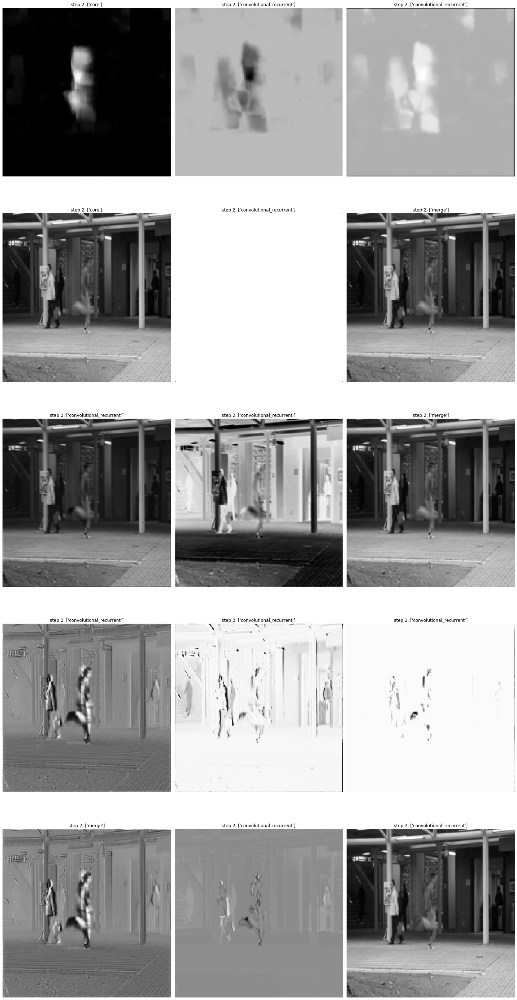

In [108]:
step = 2
idx = 0
plt.rcParams.update({'font.size': 10})

f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0], cmap='gray')            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


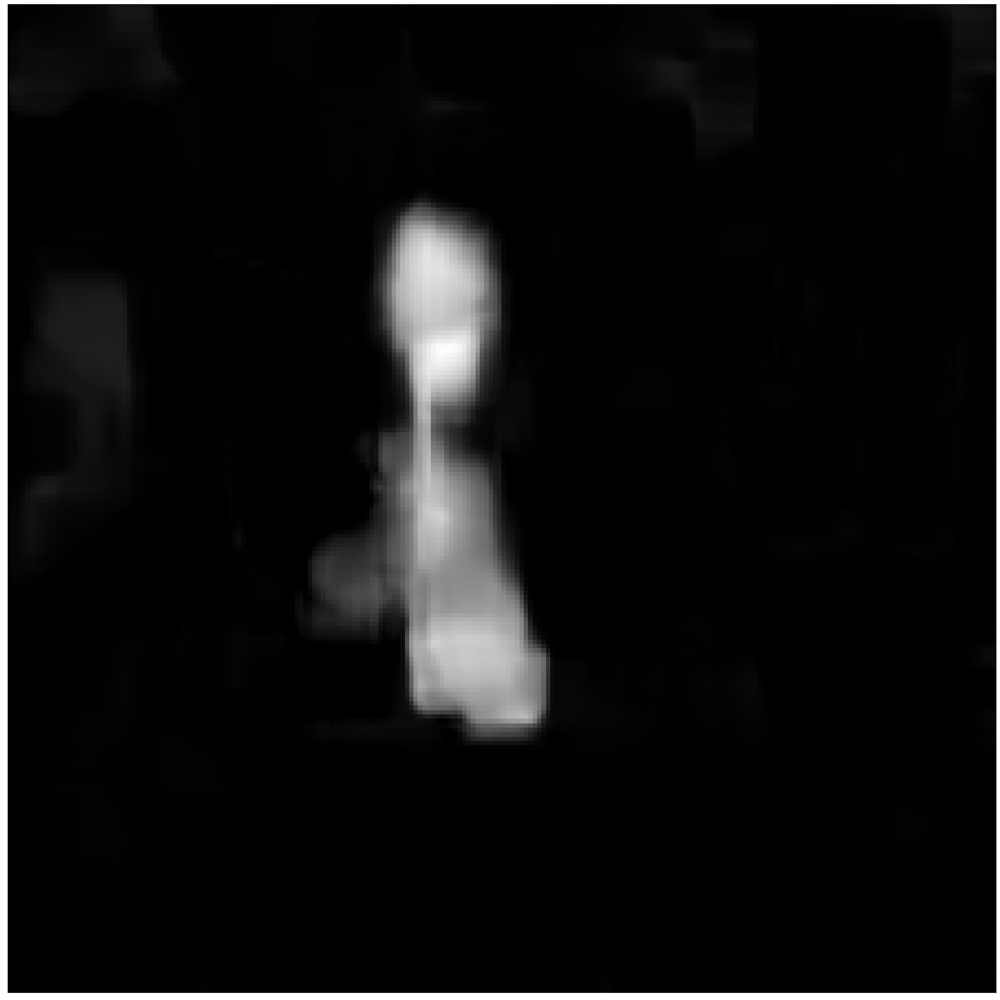

In [113]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_model_optical.pdf", format = 'pdf')

# plt.show()

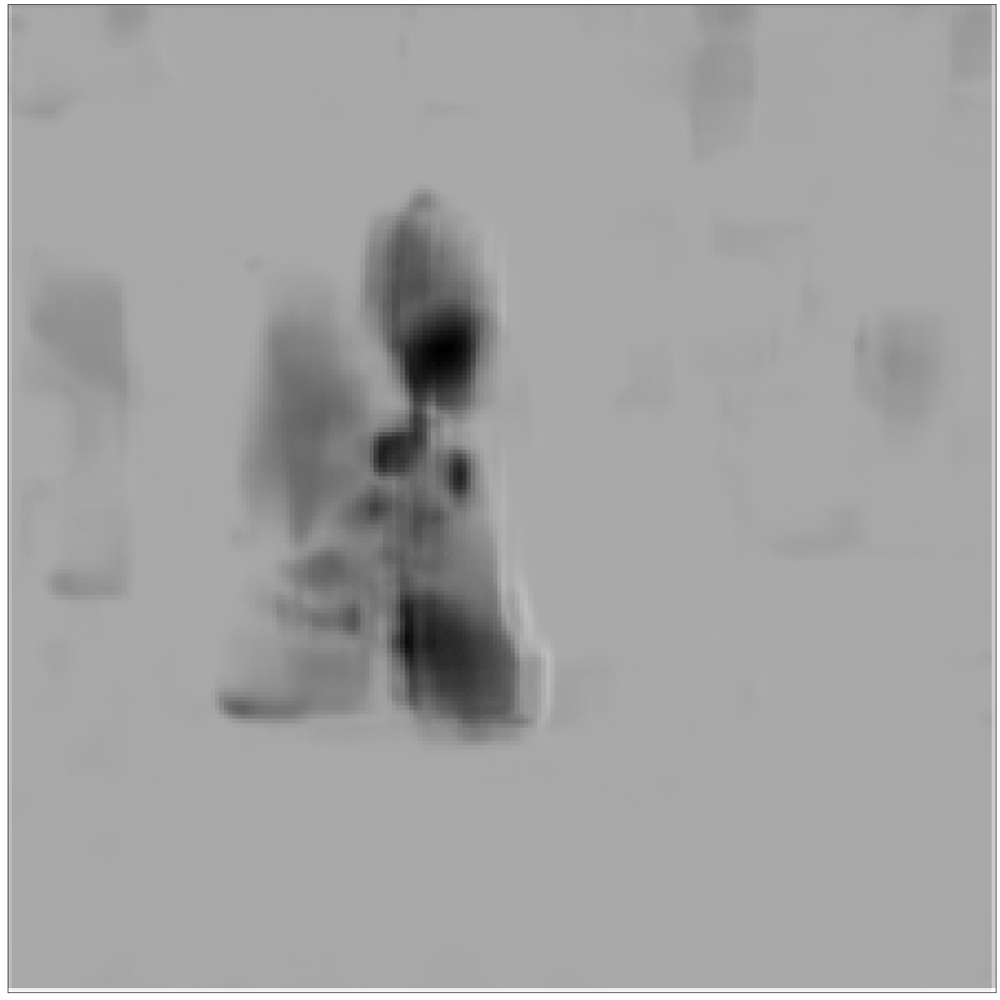

In [114]:
step = 0
idx = 1
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_model_optical_rnn.pdf", format = 'pdf')

# plt.show()

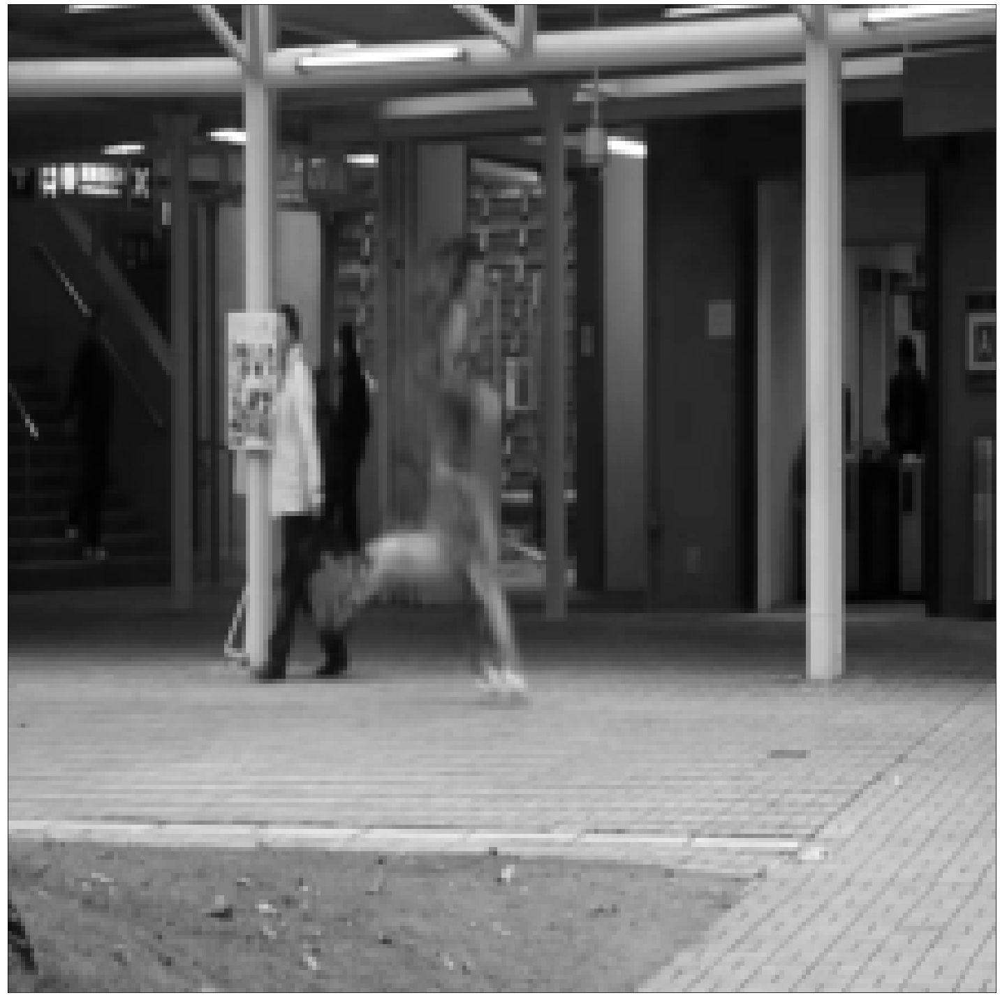

In [115]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[-1][step,:, :, 0], cmap='gray')       
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_model_last.pdf", format = 'pdf')

# plt.show()

In [ ]:
시각적인 정보를 주로 받아들여서 어탠션 이기 때문에 .. 
움직이는 사람과 뛰는 사람에 대한 마킹이 주로 되어 있음 .. 
이에 대한 설명 즉 부족하다는 것을 어필 


## no attention

In [50]:
model_name = 'avenue_3_no_attention'
model_ = load_model(runs_dict[model_name])

In [58]:
layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        print(layer_[-1])
        print(i, len(model_.layers[3].layers))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        continue
    


1 13
2 13
3 13
4 13
5 13
6 13
7 13
8 13
9 13
10 13
11 13
12 13


In [ ]:
step = 0
idx = 0
plt.rcParams.update({'font.size': 10})

f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0], cmap='gray')            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


In [ ]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_noattn_optical.pdf", format = 'pdf')

# plt.show()

In [ ]:
step = 0
idx = 1
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_noattn_optical_rnn.pdf", format = 'pdf')

# plt.show()

In [ ]:
step = 2
idx = 0
plt.rcParams.update({'font.size': 10})

f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0], cmap='gray')            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


In [ ]:
step = 0
idx = 1
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_noattn_optical_rnn.pdf", format = 'pdf')

# plt.show()

In [ ]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[-1][step,:, :, 0], cmap='gray')       
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_noattn_last.pdf", format = 'pdf')

# plt.show()

In [ ]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_anomal[idx][step, 1, :, :, 0], cmap='gray')
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_anomal_noattn_optical.pdf", format = 'pdf')

# plt.show()

In [ ]:
step = 0
idx = 0
plt.figure(figsize=(20,20))
plt.xticks([])
plt.yticks([])
plt.imshow(predict_normal[-1][step,:, :, 0], cmap='gray')       
    
# plt.subplots_adjust(left = 0.2, bottom = 0.3, right = 0.95, top = 1)
plt.tight_layout()
plt.savefig("./fig/avenue_normal_noattn_last.pdf", format = 'pdf')

# plt.show()

IndexError: list index out of range

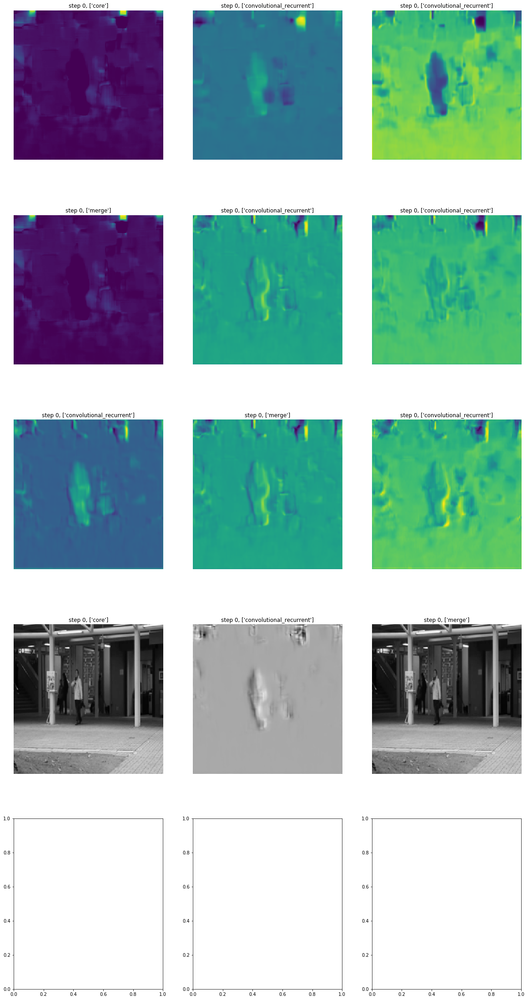

In [60]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_[idx][step, 1, :, :, 0])
        except:
            try:
                axes[i][j].imshow(predict_[idx][step,:, :, 0], cmap='gray')         
            except:
                continue
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


IndexError: list index out of range

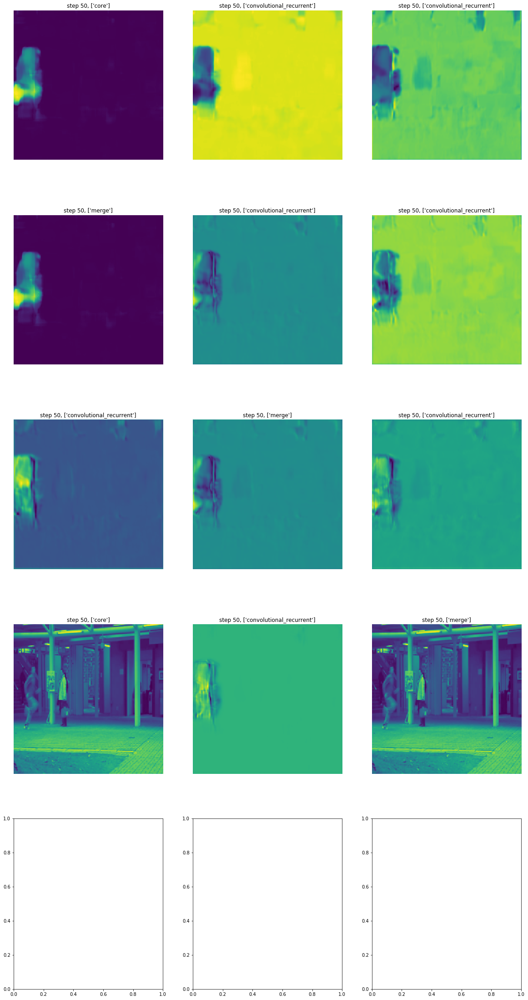

In [61]:
step = 50
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


## ours

In [67]:
model_name = 'avenue_3_ours2221122'
ours_model = load_model(runs_dict[model_name])


In [37]:
model_ = load_model(runs_dict[model_name])

layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        print("error")
        break
print("end")

end


IndexError: list index out of range

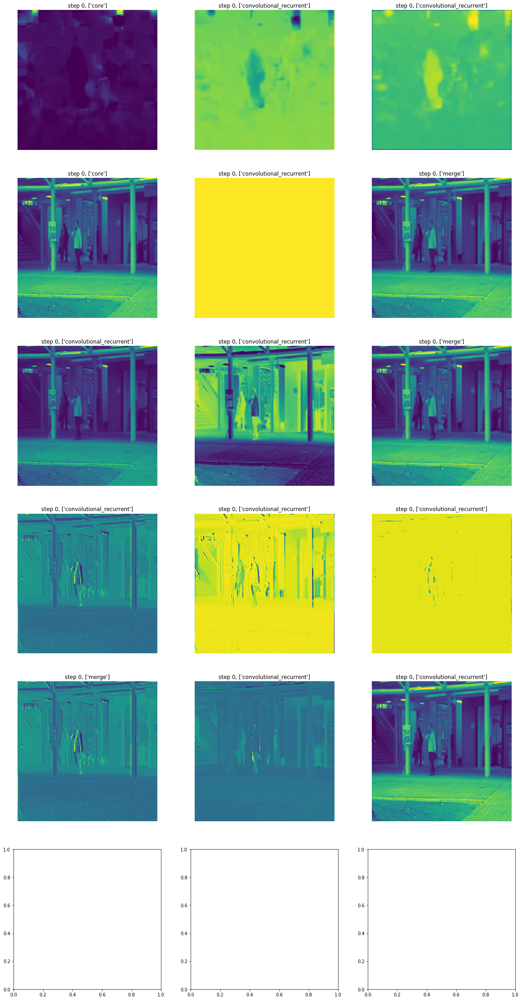

In [45]:
step = 0
idx = 0


f, axes = plt.subplots(6, 3, figsize=(20,40))

for i in range(6):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


IndexError: list index out of range

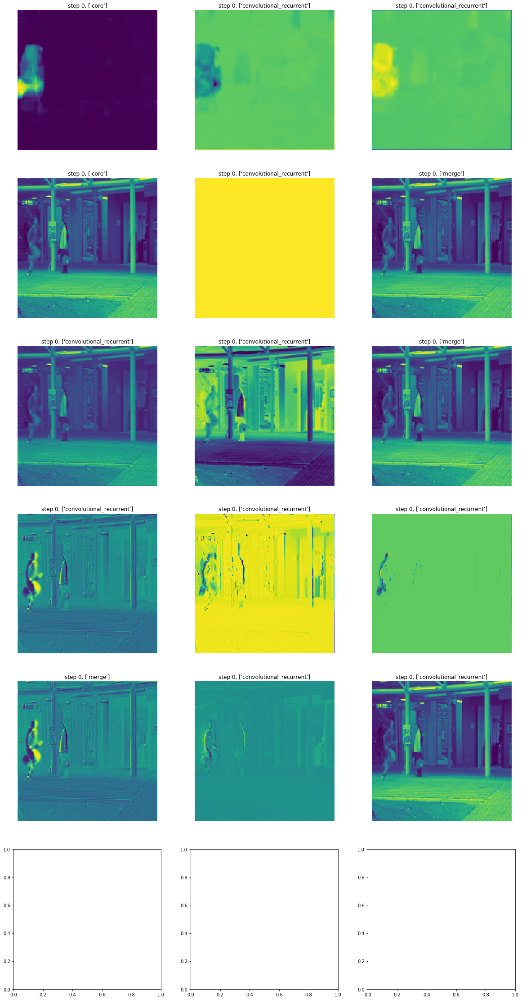

In [43]:
step = 0
idx = 0


f, axes = plt.subplots(6, 3, figsize=(20,40))

for i in range(6):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


# exit

## analysis

In [6]:
# 수정된 check result
def check_result(selected_test_video = 0, \
                 model_name = 'avenue_3_no_residual', image_size = 224,\
                sequence_start_idx = 4, video_range1 = 0,
                video_range2 = 100):
    
    mse_path = '/home/mjh319/workspace/video_anomaly/mse/'

    label = Y_label_generator_2(model_name.split('_')[0])
    
    dataset = model_name.split('_')[0]
    stride = 1
    timesteps = int(model_name.split('_')[1])
    
    
    
    if dataset =='avenue':
        test_videos_path = './data/Avenue Dataset/testing_frames/'
    elif dataset == 'ped1' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped1/'
    elif dataset == 'ped2' :
        test_videos_path = './data/UCSD_Anomaly_Dataset/UCSD_Anomaly_Dataset.v1p2/UCSDped2/'
    elif dataset == 'enter' :
        test_videos_path = './data/subway/enter/testing_frames/'
    elif dataset == 'exit' :
        test_videos_path = './data/subway/exit/testing_frames/'
    elif dataset == 'shang':
        test_videos_path = './data/shanghaitech/testing/frames/'       
        
    all_mse = dict()
    if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
        test_video_list = np.sort(os.listdir(test_videos_path))
    elif dataset == 'ped1' or dataset == 'ped2':
        test_video_list = np.sort([folder for folder in os.listdir(os.path.join(test_videos_path,'Test')) if 'Test' in folder if 'gt' not in folder])


    test_label = {}    
    
    len_ = 0
   

    print("video list len {}".format(len(test_video_list)))
    for idx, video in enumerate(test_video_list) :
        
        if idx != selected_test_video :
            len_ += len(label[video])
            continue

        
        if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
            f_len = len(os.listdir(os.path.join(test_videos_path, video)))
            if dataset == 'shang':
                video_frames = [str(file).zfill(3) + '.jpg' for file in list(range(f_len))]
            else :
                video_frames = [str(file) + '.jpg' for file in list(range(f_len))]
            
            if dataset == 'exit':
                video_frames = video_frames[video_range1:video_range2]
                f_len = len(video_frames)
                label[video] = label[video][video_range1:video_range2]
                
            if dataset == 'enter':
                video_frames = video_frames[video_range1:video_range2]
                f_len = len(video_frames)
                label[video] = label[video][video_range1:video_range2]
                
        elif dataset == 'ped1' or dataset == 'ped2':    
            video_frames = np.sort([file for file in os.listdir(os.path.join(test_videos_path,'Test',video)) if 'tif' in file])
            f_len = len(video_frames)
            
            
        with open(os.path.join(mse_path, model_name + '.pkl'), 'rb') as f:
            mse = pickle.load(f)
        mse = mse[len_:len_+f_len]
            
            
            
        end_idx = (f_len//stride) * stride -1
        while end_idx + timesteps -1 > f_len -1 :
            end_idx -= stride 

        num_sample = (end_idx+1)//stride    
        
        batch_size = end_idx        
        cnt = 1
            
            
        for i in tnrange(cnt, desc='test : {}'.format(video)):
            batch = []
            batch_y = [] 
            normal_batch = []
            
            for sequence_start_idx in list(range(1,end_idx, stride))[i*batch_size:i*batch_size+batch_size]:

                resized_frames = [] # sequence
                sequence = video_frames[sequence_start_idx-1:sequence_start_idx+timesteps+1] # [t-1 , t , t+1, t+2]            


                # t-1 sample 
                if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                    prv = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[0]), mode='L')

                elif dataset == 'ped1' or dataset =='ped2':
                    prv = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[0]), mode='L')
                    
                    
                    
                normal_batch.append(prv)
                

                prv = scipy.misc.imresize(prv, (image_size,image_size))

                if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                    frame_y = scipy.misc.imread(os.path.join(test_videos_path,video,sequence[-1]), mode='L')

                elif dataset == 'ped1' or dataset =='ped2':
                    frame_y = scipy.misc.imread(os.path.join(test_videos_path,'Test',video, sequence[-1]), mode='L')

                frame_y = scipy.misc.imresize(frame_y, (image_size,image_size))
                batch_y.append(frame_y)

                for name in sequence[1:-1]:
                    if dataset =='avenue' or dataset == 'enter' or dataset == 'exit' or dataset == 'shang':
                        nxt = scipy.misc.imread(os.path.join(test_videos_path,video,name), mode='L')
                    elif dataset == 'ped1' or dataset == 'ped2':
                        nxt = scipy.misc.imread(os.path.join(test_videos_path,'Test',video,name), mode='L') # 'L = gray'  

                    nxt = scipy.misc.imresize(nxt, (image_size,image_size))
                    
                    
                    

                    flow = cv2.calcOpticalFlowFarneback(prv,nxt, None, 0.5, 3, 15, 3, 5, 1.2, 0)
                    mag, ang = cv2.cartToPolar(flow[...,0], flow[...,1])

                    hsv = np.zeros((image_size,image_size,3))
                    hsv[...,1] = 255.  
                    hsv[...,0] = ang*180/np.pi/2
                    hsv[...,2] = cv2.normalize(mag,None,0,255,cv2.NORM_MINMAX)
                    hsv = np.uint8(hsv) 

                    rgb = cv2.cvtColor(hsv,cv2.COLOR_HSV2RGB)
                    rgb = rgb/255.             

                    nxt = np.expand_dims(nxt, axis=-1)
                    frame = np.concatenate([nxt/255.,rgb],axis = -1)                        
                    resized_frames.append(frame)
                    prv = nxt.copy()                        

                resized_frames = np.stack(resized_frames, axis=0)
                batch.append(resized_frames)

            if batch !=[]: 
                batch = np.stack(batch, axis = 0)
                normal_batch = np.stack(normal_batch, axis = 0)
                batch_y = np.stack(batch_y, axis = 0)
                batch_y = np.expand_dims(batch_y/255., axis=-1)
                
        test_label[video] = label[video][timesteps+1 : ]
        label_each, = np.where(test_label[video] == 1)
        return_label = test_label[video]
        
        groups = []
        for k, g in groupby(enumerate(label_each), lambda x: x[0]-x[1]):
            groups.append(list(map(itemgetter(1), g))) 
    

        plt.figure(figsize=(20,5))
        plt.xlabel('Frame number')
        plt.title('{} video #{}'.format(dataset, video))
        plt.plot(mse)
        for i in range(len(groups)):
            plt.axvspan(groups[i][0] , groups[i][-1], facecolor='r', alpha=0.2)

        plt.show()

    return batch, normal_batch, return_label, mse

video list len 4


/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:89: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:99: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:102: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/home/mjh319/anaconda3/envs/videoanomal/lib/python3.6/site-packages/ipykernel_launcher.py:107: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
/home/mjh319/a

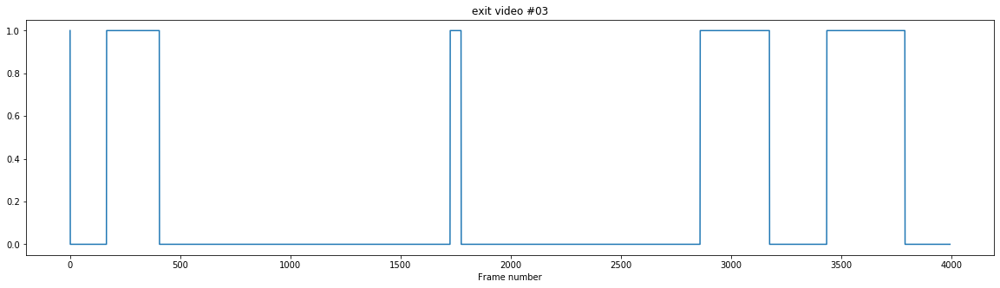

In [7]:
model_name = 'exit_3_convLSTM_res_flow'

test_batch, orginal_batch, label = check_result(selected_test_video = 2, \
                   model_name = model_name ,image_size = 224,\
                   sequence_start_idx = 4, video_range1 = 10000, video_range2 = 14000)

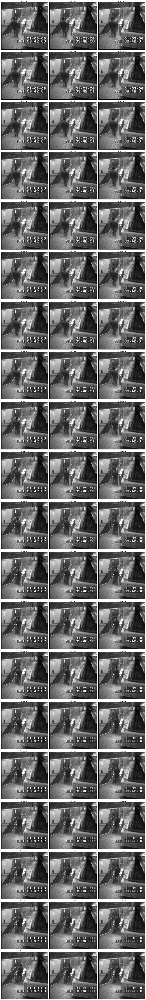

In [9]:
frame_num = 2960
stack_ = 0
_,_,x,y,_ =test_batch.shape

# fig = plt.figure(figsize=(40, 40)) 
row_ = 20
col_ = 3
f, axes = plt.subplots(row_, col_, figsize=(col_*7,row_*7))

for i in range(row_):
    for j in range(col_):
        temp = test_batch[frame_num+(i*col_ + j), 0,:,:, stack_].reshape(x,y)
        axes[i][j].set_title("frame "+str(frame_num+(i*col_ + j)) +", " +str(label[frame_num+(i*col_ + j)]))
        axes[i][j].imshow(temp, cmap='gray')
        axes[i][j].axis('off')
plt.tight_layout()
plt.show()       


## no resi

In [10]:
model_ = load_model(runs_dict[model_name])

normal_batch = test_batch[2700:2705, :, :, :, :]
anomal_batch = test_batch[3000:3050, :, :, :, :]

In [21]:
layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        print(layer_[-1])
        print(i, len(model_.layers[3].layers))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        continue
    


1 18
2 18
3 18
4 18
5 18
6 18
7 18
8 18
9 18
10 18
11 18
12 18
13 18
14 18
15 18
16 18
17 18


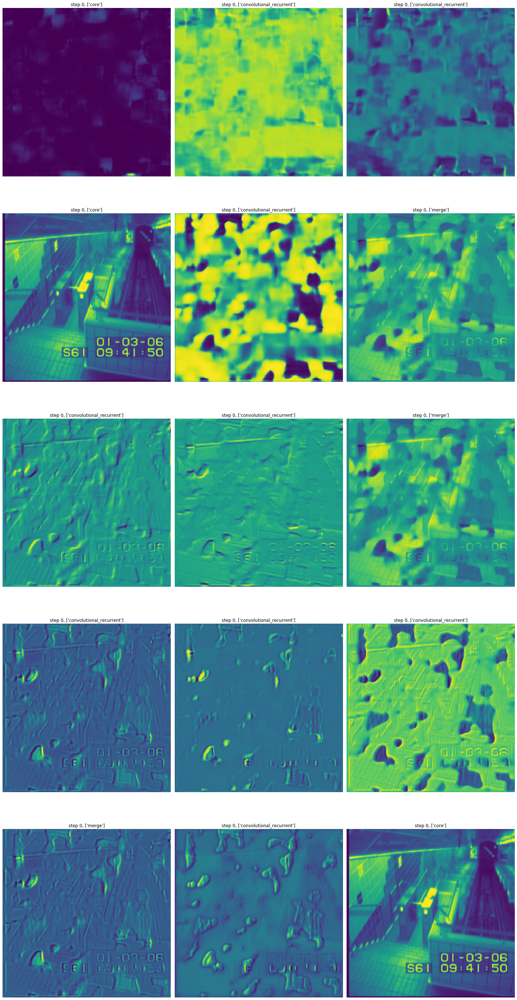

In [23]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


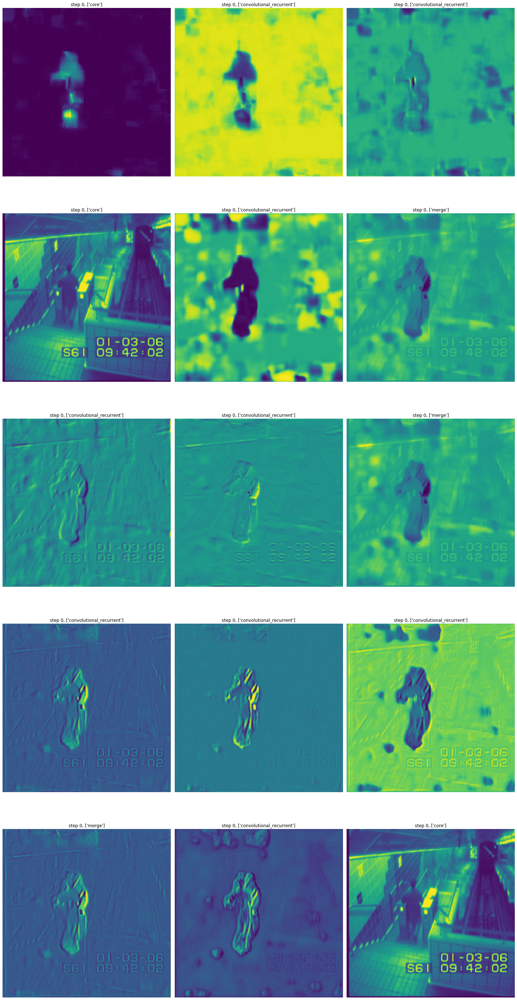

In [24]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


## no atten

In [25]:
model_name = 'exit_3_no_attention'
model_ = load_model(runs_dict[model_name])

# normal_batch = test_batch[2700:2705, :, :, :, :]
# anomal_batch = test_batch[3000:3050, :, :, :, :]

layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        print("error")
        break
print("end")

IndexError: list index out of range

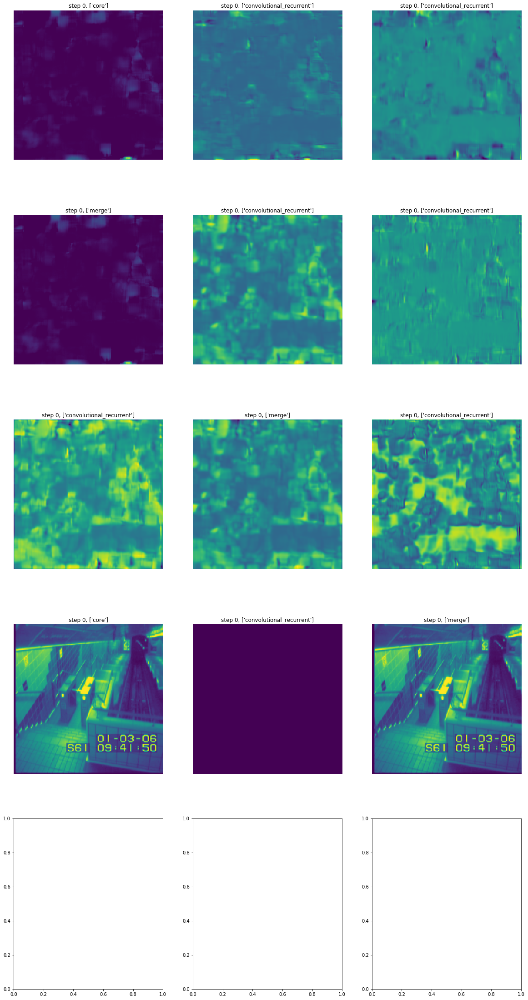

In [27]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


IndexError: list index out of range

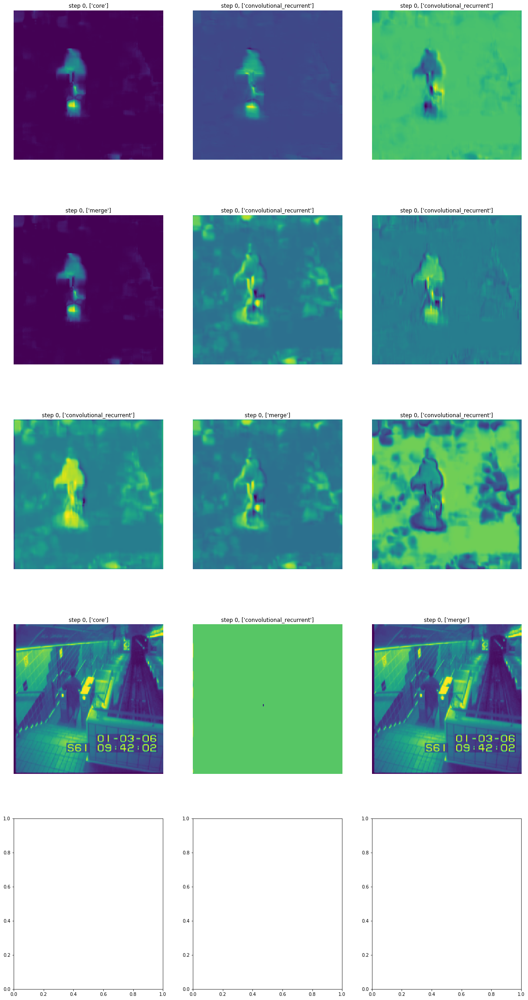

In [28]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


## ours

In [29]:
model_name = 'exit_3_convLSTM_res_flow'
model_ = load_model(runs_dict[model_name])

# normal_batch = test_batch[2700:2705, :, :, :, :]
# anomal_batch = test_batch[3000:3050, :, :, :, :]

layer_ = []
predict_normal = []
predict_anomal = []

for i in range(1, len(model_.layers[3].layers)):
    try:
        layer_.append(keras.utils.multi_gpu_model(Model(inputs = \
                                              model_.layers[3].layers[0].input, \
                                              outputs =model_.layers[3].layers[i].output ), gpus=2))
        predict_normal.append(layer_[-1].predict_on_batch(normal_batch))
        predict_anomal.append(layer_[-1].predict_on_batch(anomal_batch))
    except:
        print("error")
        break
print("end")

end


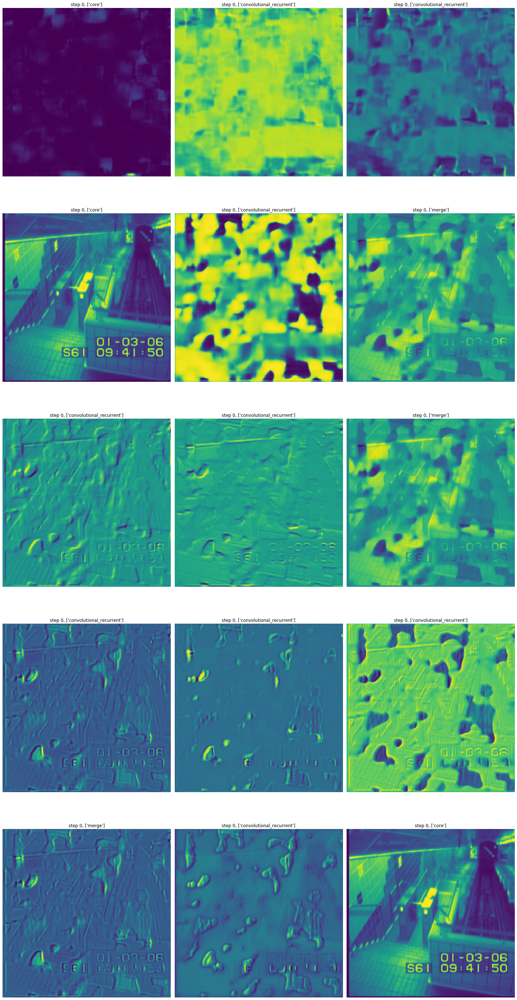

In [30]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_normal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_normal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


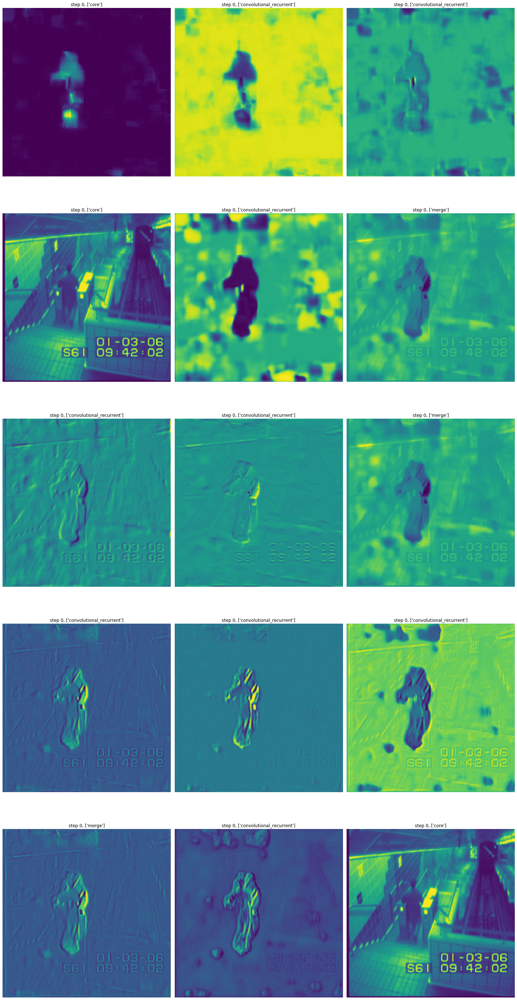

In [31]:
step = 0
idx = 0


f, axes = plt.subplots(5, 3, figsize=(20,40))

for i in range(5):
    for j in range(3):
        axes[i][j].set_title("step "+str(step) +", " + str(str(layer_[idx].layers[3].layers[-1]).split('.')[2:-1]))
        try:
            axes[i][j].imshow(predict_anomal[idx][step, 1, :, :, 0])
        except:
            axes[i][j].imshow(predict_anomal[idx][step,:, :, 0])            
        idx += 1
        axes[i][j].axis('off')    
        
plt.tight_layout()
plt.show()       


# entrance

## analysis

# 기타

## 모델 통과한 후의 이미지

In [75]:
runs_dict['avenue_3_no_residual']

'/home/mjh319/workspace/runs/dataset_avenue_image_size_224_timesteps_3_epochs_100_model_convLSTM_attention_pred_checkname_no_residual/no_residual/100-0.00007328.hdf5'

In [70]:
multi_gpus_model = load_model(runs_dict['ped1_3_no_attention'])

In [55]:
show_batch = test_batch[4:5]

In [56]:
pred_batch = multi_gpus_model.predict_on_batch(show_batch)
mse_batch = np.square(show_batch[:,1:,:,:,:1]-pred_batch)

In [59]:
show_batch.shape

(1, 3, 224, 224, 4)

In [57]:
pred_batch.shape

(1, 224, 224, 1)

In [61]:
mse_batch.shape

(1, 2, 224, 224, 1)

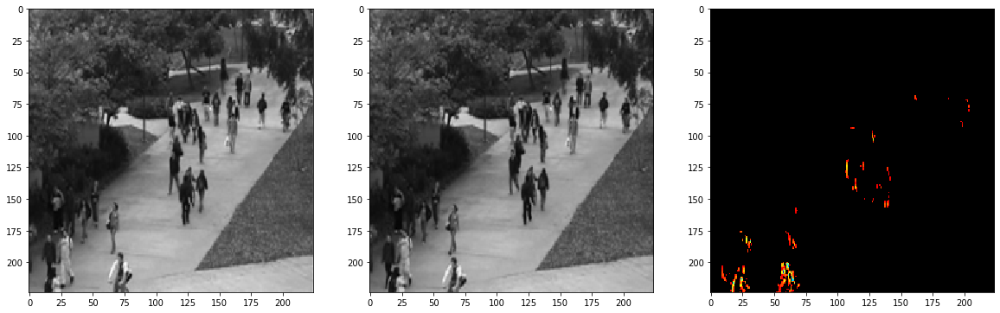

In [63]:

plt.figure(figsize=(20,10))
plt.subplot(1,3,1)
plt.imshow(show_batch[0,0,:,:,0],cmap='gray')
plt.subplot(1,3,2)
plt.imshow(show_batch[0,1,:,:,0],cmap='gray')
plt.subplot(1,3,3)
#ax = sns.heatmap(mse_batch[i,j,:,:,0], linewidth=0.5)
cam = mse_batch[0,1,:,:,0]/np.max(mse_batch[0,1,:,:,0])
heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
heatmap[np.where(cam < 0.1)] = 0
plt.imshow(heatmap)
plt.show()


In [67]:
multi_gpus_model.layers[3].layers

In [71]:
multi_gpus_model.layers[3].layers

In [72]:
multi_gpus_model.layers[3].layers

In [73]:
conv1 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[2].output )
conv2 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[3].output )
conv3 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[4].output )
mul = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[5].output )
conv4 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[6].output )
conv5 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[7].output )
concat1 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[8].output )
conv6 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[9].output )
conv7 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[10].output )
conv8 =  Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[11].output )
concat2 =  Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[12].output )


In [64]:
conv1 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[2].output )
conv2 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[3].output )
conv3 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[5].output )
mul = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[6].output )
conv4 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[7].output )
conv5 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[8].output )
concat1 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[9].output )
conv6 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[10].output )
conv7 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[11].output )
conv8 =  Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[12].output )
concat2 =  Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[13].output )
conv9 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[14].output )
conv10 = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[16].output )
out = Model(inputs = multi_gpus_model.layers[3].layers[0].input, outputs =multi_gpus_model.layers[3].layers[-1].output )


In [65]:
batch = show_batch
pred_conv1 = conv1.predict_on_batch(batch)
pred_conv2 = conv2.predict_on_batch(batch)
pred_conv3 = conv3.predict_on_batch(batch)
pred_mul = mul.predict_on_batch(batch)
pred_conv4 = conv4.predict_on_batch(batch)
pred_conv5 = conv5.predict_on_batch(batch)
pred_concat1 = concat1.predict_on_batch(batch)
pred_conv6 = conv6.predict_on_batch(batch)
pred_conv7 = conv7.predict_on_batch(batch)
pred_conv8 = conv8.predict_on_batch(batch)
pred_concat2 = concat2.predict_on_batch(batch)
pred_conv9 = conv9.predict_on_batch(batch)
pred_conv10 = conv10.predict_on_batch(batch)
pred_out = out.predict_on_batch(batch)


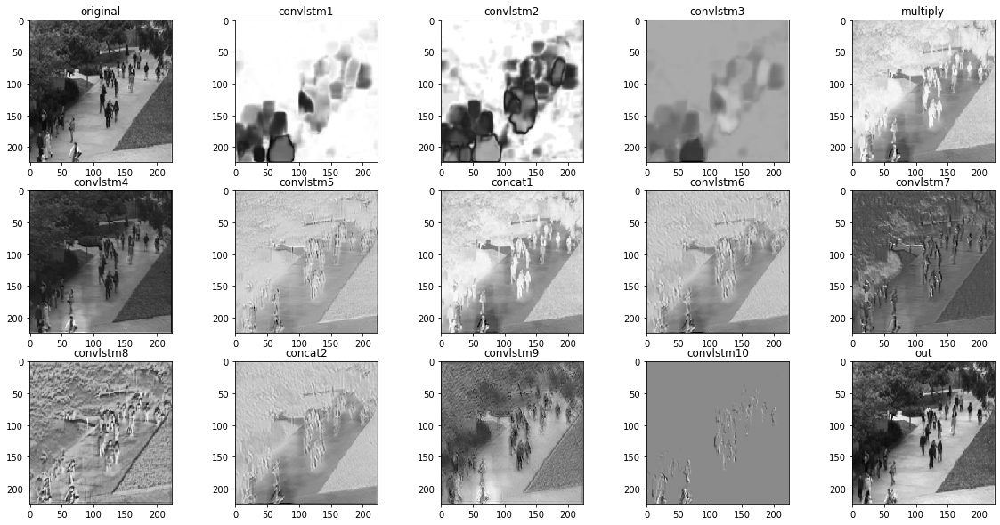

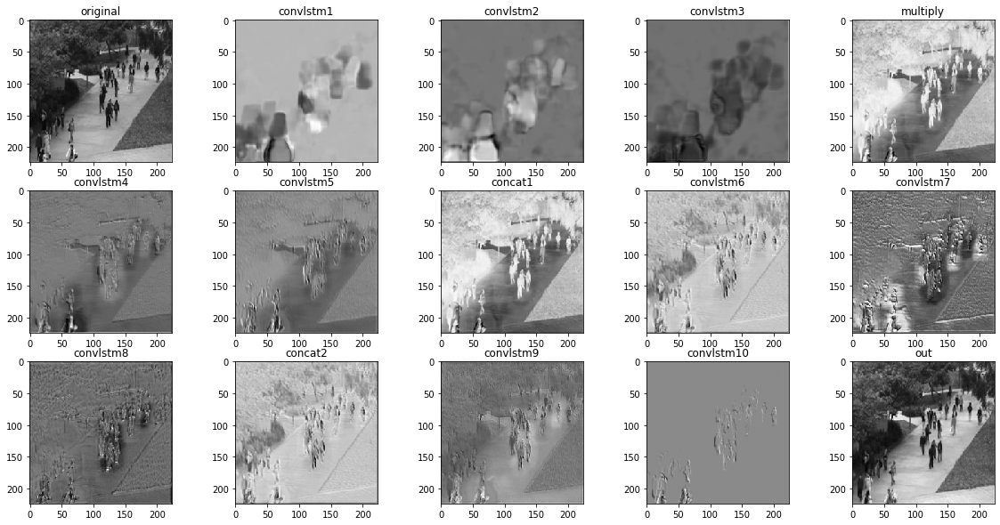

IndexError: index 1 is out of bounds for axis 0 with size 1

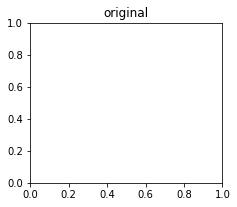

In [66]:

for i in range(2):
    for j in range(2):
        plt.figure(figsize=(20,10))
        plt.subplot(3,5,1)
        plt.title("original")
        plt.imshow(batch[i,j,:,:,0], cmap='gray') 
        plt.subplot(3,5,2)
        plt.title("convlstm1")
        plt.imshow(pred_conv1[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,3)
        plt.title("convlstm2")
        plt.imshow(pred_conv2[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,4)
        plt.title("convlstm3")
        plt.imshow(pred_conv3[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,5)
        plt.title("multiply")
        plt.imshow(pred_mul[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,6)
        plt.title("convlstm4")
        plt.imshow(pred_conv4[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,7)
        plt.title("convlstm5")
        plt.imshow(pred_conv5[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,8)
        plt.title("concat1")
        plt.imshow(pred_concat1[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,9)
        plt.title("convlstm6")
        plt.imshow(pred_conv6[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,10)
        plt.title("convlstm7")
        plt.imshow(pred_conv7[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,11)
        plt.title("convlstm8")
        plt.imshow(pred_conv8[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,12)
        plt.title("concat2")
        plt.imshow(pred_concat2[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,13)
        plt.title("convlstm9")
        plt.imshow(pred_conv9[i,j,:,:,0], cmap='gray')
        plt.subplot(3,5,14)
        plt.title("convlstm10")
        plt.imshow(pred_conv10[i,:,:,0], cmap='gray')
        plt.subplot(3,5,15)
        plt.title("out")
        plt.imshow(pred_out[i,:,:,0], cmap='gray')
        plt.show()
        
        
        

## 그림

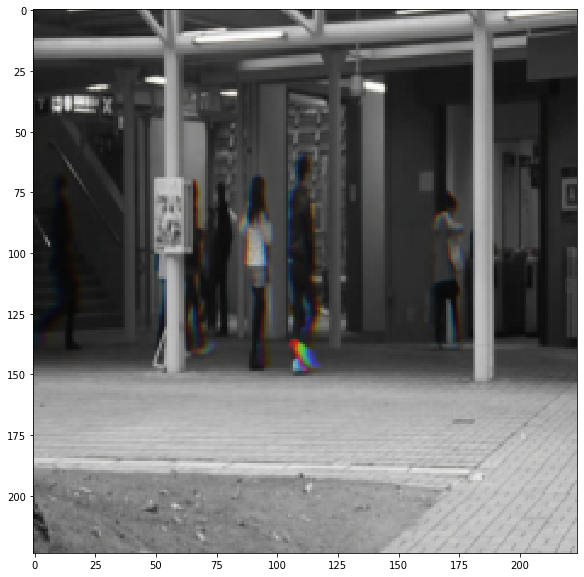

In [47]:
plt.figure(figsize=(20,10))
temp = np.transpose(test, (1,2,0,3))
plt.imshow(temp[:,:,:,0])

NameError: name 'batch' is not defined

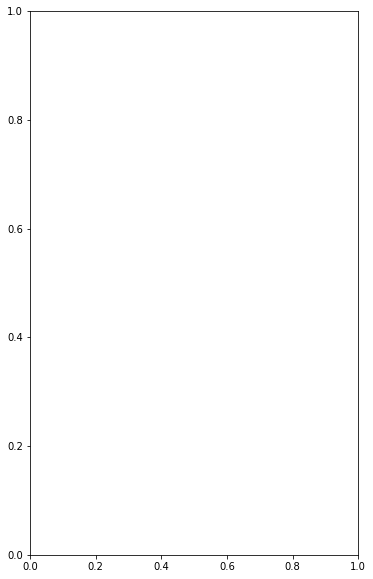

In [42]:
for i in range(20):
    for j in range(2) :
        plt.figure(figsize=(20,10))
        plt.subplot(1,3,1)
        plt.imshow(batch[i,j+1,:,:,0],cmap='gray')
        plt.subplot(1,3,2)
        plt.imshow(pred_batch[i,j,:,:,0],cmap='gray')
        plt.subplot(1,3,3)
        #ax = sns.heatmap(mse_batch[i,j,:,:,0], linewidth=0.5)
        cam = mse_batch[i,j,:,:,0]/np.max(mse_batch[i,j,:,:,0])
        heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
        heatmap[np.where(cam < 0.1)] = 0
        plt.imshow(heatmap*0.5 + pred_batch[i,j,:,:,:1])
        plt.show()
        